## Stereo Inference with MiniProjector Flight Visualization

This notebook performs:
1. Image loading from IPSL and ECTL cameras
2. Mask2Former inference for contrail segmentation
3. Flight projection using MiniProjector (geometric method)

## 1. Import Dependencies

In [1]:
import sys
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import datetime
import re
from pathlib import Path
from typing import List, Tuple, Dict
from tqdm import tqdm
import pandas as pd
import pytz
from geographiclib.geodesic import Geodesic
from shapely import transform
from shapely.geometry.base import BaseGeometry
from numpy.typing import NDArray

# Import ML libraries
import torch
from transformers import (
    Mask2FormerImageProcessor,
    Mask2FormerForUniversalSegmentation,
)

print(f"✓ PyTorch {torch.__version__}")
print(f"✓ CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"  Device: {torch.cuda.get_device_name(0)}")
print("✓ All libraries imported successfully")

/data/dataiku/.conda/envs/stereo/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


✓ PyTorch 2.9.1+cu128
✓ CUDA available: True
  Device: NVIDIA RTX 6000 Ada Generation
✓ All libraries imported successfully


## 2. Configuration

In [2]:
# Set CUDA device
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

# Dataset paths
workspace_dir = Path("/data/common/STEREOSTUDYIPSL")
datasets_dir = workspace_dir / "Datasets"

DATASET1_NAME = "gQg5IUvV"  # IPSL dataset
DATASET2_NAME = "OdnkTZQ8"  # ECTL dataset

dataset1_dir = datasets_dir / DATASET1_NAME / "PROJECTED"
dataset2_dir = datasets_dir / DATASET2_NAME / "PROJECTED"

# Model configuration
task = "panoptic"
model_size = "base"
run_id = "polygon"

trailvision_dir = Path("/data/common/TRAILVISION")
segmentation_dir = trailvision_dir / "segmentation"
models_dir = segmentation_dir / "models"
checkpoint_dir = models_dir / task / run_id

# Camera locations
SIRTA_LAT = 48.7132
SIRTA_LON = 2.207
SIRTA_HEIGHT = 177.5  # meters

ECTL_LAT = 48.600518087374105
ECTL_LON = 2.3467954996250784
ECTL_ALT = 90  # meters

print(f"Dataset 1 (IPSL): {dataset1_dir}")
print(f"  Exists: {dataset1_dir.exists()}")
print(f"Dataset 2 (ECTL): {dataset2_dir}")
print(f"  Exists: {dataset2_dir.exists()}")
print(f"Model checkpoint: {checkpoint_dir}")
print(f"  Exists: {checkpoint_dir.exists()}")

Dataset 1 (IPSL): /data/common/STEREOSTUDYIPSL/Datasets/gQg5IUvV/PROJECTED
  Exists: True
Dataset 2 (ECTL): /data/common/STEREOSTUDYIPSL/Datasets/OdnkTZQ8/PROJECTED
  Exists: True
Model checkpoint: /data/common/TRAILVISION/segmentation/models/panoptic/polygon
  Exists: True


## 3. Load Model and Processor

In [3]:
# Base model
base_model = "/data/common/STEREOSTUDYIPSL/Codebase/FineTuning/contrail_segmentation"

# Define categories
categories = [
    {"id": 1, "name": "contrail", "isthing": 1, "color": [255, 0, 0]},
]
if task == "panoptic":
    background_category_id = len(categories) + 1
    categories.append(
        {
            "id": background_category_id,
            "name": "sky",
            "isthing": 0,
            "color": [135, 206, 235],
        }
    )

# Create id2label mapping
id2label = {id: label["name"] for id, label in enumerate(categories)}
print(f"Categories: {id2label}")

# Image processor
processor = Mask2FormerImageProcessor.from_pretrained(
    base_model,
    do_resize=False,
    do_rescale=False,
    do_normalize=True,
    do_reduce_labels=True,
    ignore_index=255,
)

print("✓ Processor loaded")

# Load model
model = Mask2FormerForUniversalSegmentation.from_pretrained(
    checkpoint_dir,
    id2label=id2label,
    ignore_mismatched_sizes=True,
)
device = "cuda" if torch.cuda.is_available() else "cpu"
model = model.to(device)
model.eval()

print(f"✓ Model loaded on {device}")
print(f"  Model classes: {model.config.num_labels}")

Categories: {0: 'contrail', 1: 'sky'}
✓ Processor loaded
✓ Model loaded on cuda
  Model classes: 2


## 4. Load Datasets

In [4]:
# Find all projected images
dataset1_images = sorted(list(dataset1_dir.glob('*.jpg')))
dataset2_images = sorted(list(dataset2_dir.glob('*.jpg')))

print(f"Dataset 1 (IPSL): {len(dataset1_images)} images")
print(f"Dataset 2 (ECTL): {len(dataset2_images)} images")

Dataset 1 (IPSL): 323 images
Dataset 2 (ECTL): 1441 images


## 5. Timestamp Matching Functions

In [5]:
def extract_timestamp_from_ipsl(filename: str) -> datetime.datetime:
    """Extract timestamp from IPSL filename format: YYYYMMDDHHMMSS_XX.jpg"""
    match = re.search(r'(\d{14})', filename)
    if match:
        timestamp_str = match.group(1)
        return datetime.datetime.strptime(timestamp_str, '%Y%m%d%H%M%S')
    return None

def extract_timestamp_from_ectl(filename: str) -> datetime.datetime:
    """Extract timestamp from ECTL filename format: image_YYYYMMDDHHMMSS.jpg"""
    match = re.search(r'image_(\d{14})', filename)
    if match:
        timestamp_str = match.group(1)
        return datetime.datetime.strptime(timestamp_str, '%Y%m%d%H%M%S')
    return None

def find_matching_image_pairs(dataset1_images: List[Path], dataset2_images: List[Path]) -> List[Dict]:
    """Find image pairs with matching timestamps."""
    # Parse timestamps
    dataset1_parsed = []
    for img_path in dataset1_images:
        timestamp = extract_timestamp_from_ipsl(img_path.name)
        if timestamp:
            dataset1_parsed.append({'path': img_path, 'timestamp': timestamp, 'filename': img_path.name})
    
    dataset2_parsed = []
    for img_path in dataset2_images:
        timestamp = extract_timestamp_from_ectl(img_path.name)
        if timestamp:
            dataset2_parsed.append({'path': img_path, 'timestamp': timestamp, 'filename': img_path.name})
    
    # Find exact matches
    matched_pairs = []
    for item1 in dataset1_parsed:
        for item2 in dataset2_parsed:
            if item1['timestamp'] == item2['timestamp']:
                matched_pairs.append({
                    'ipsl_path': item1['path'],
                    'ipsl_filename': item1['filename'],
                    'ectl_path': item2['path'],
                    'ectl_filename': item2['filename'],
                    'timestamp': item1['timestamp']
                })
                break
    
    return matched_pairs

print("✓ Timestamp matching functions defined")

✓ Timestamp matching functions defined


## 6. Find Matched Image Pairs

In [6]:
matched_pairs = find_matching_image_pairs(dataset1_images, dataset2_images)

# Filter for specific time window (1-3pm)
filtered_pairs = [pair for pair in matched_pairs if 11 <= pair['timestamp'].hour < 13]
matched_pairs = filtered_pairs

print(f"✓ Found {len(matched_pairs)} matched pairs (1-3pm window)")
if len(matched_pairs) > 0:
    print(f"  First pair: {matched_pairs[0]['timestamp']}")
    print(f"  Last pair: {matched_pairs[-1]['timestamp']}")

✓ Found 60 matched pairs (1-3pm window)
  First pair: 2025-04-06 11:00:00
  Last pair: 2025-04-06 12:58:00


## 7. Inference Function

In [7]:
def run_inference(image: np.ndarray, threshold=0.5, mask_threshold=0.5, overlap_threshold=0.8):
    """Run segmentation inference on an image."""
    inputs = processor([image], return_tensors="pt").to(device)
    
    with torch.no_grad():
        outputs = model(**inputs)
    
    target_sizes = [image.shape[:2]]
    
    if task == "panoptic":
        kwargs = {
            "threshold": threshold,
            "mask_threshold": mask_threshold,
            "overlap_mask_area_threshold": overlap_threshold,
        }
        segmentation = processor.post_process_panoptic_segmentation(
            outputs,
            target_sizes=target_sizes,
            **kwargs
        )[0]
    
    return segmentation

print("✓ Inference function defined")

✓ Inference function defined


## 8. MiniProjector Class

In [8]:
def ft_to_m(ft: NDArray) -> NDArray:
    """Convert feet to meters."""
    return ft * 0.3048


class MiniProjector:
    """Geometric projection for aircraft positions to camera pixels."""
    
    def __init__(
        self,
        camera_lat: float,
        camera_lon: float,
        camera_alt: float,
        cloud_height: float = 10000,
        square_size: float = 75000,
        resolution: int = 1024,
    ):
        self.camera_lat = camera_lat
        self.camera_lon = camera_lon
        self.camera_alt = camera_alt
        self.cloud_height = cloud_height
        self.square_size = square_size
        self.resolution = resolution
        self.half = square_size / 2
        self.step = square_size / (resolution - 1)
        self.geod = Geodesic.WGS84
    
    def calculate_azimuth_zenith(self, lat, lon, alt_ft):
        """Compute azimuth (deg) and zenith (deg) from camera to target."""
        alt_m = ft_to_m(np.asarray(alt_ft))
        
        inv_results = [
            self.geod.Inverse(self.camera_lat, self.camera_lon, la, lo)
            for la, lo in zip(np.atleast_1d(lat), np.atleast_1d(lon))
        ]
        
        azi1 = np.array([res["azi1"] for res in inv_results])
        s_ground = np.array([res["s12"] for res in inv_results])
        
        dz = alt_m - self.camera_alt
        straight = np.sqrt(s_ground**2 + dz**2)
        elevation = np.degrees(np.arcsin(dz / straight))
        zenith = 90.0 - elevation
        
        if np.isscalar(lat) and np.isscalar(lon) and np.isscalar(alt_ft):
            return azi1.item(), zenith.item()
        return azi1, zenith
    
    def azimuth_zenith_to_xy(self, azimuth_deg, zenith_deg):
        """Convert azimuth/zenith to projection plane (x,y) in meters."""
        az = np.radians(azimuth_deg)
        ze = np.radians(zenith_deg)
        r = self.cloud_height * np.tan(ze)
        x = r * np.cos(az)
        y = r * np.sin(az)
        return y + self.half, self.half - x
    
    def xy_to_pixels(self, x, y):
        """Convert (x,y) in meters to pixel coordinates."""
        px = x / self.step
        py = y / self.step
        return px, py
    
    def lonlat_to_pixels(self, lon_deg, lat_deg, alt_ft) -> Tuple[NDArray, NDArray]:
        """Convert lon/lat/altitude to pixel coordinates."""
        az_deg, ze_deg = self.calculate_azimuth_zenith(lat_deg, lon_deg, alt_ft)
        x, y = self.azimuth_zenith_to_xy(az_deg, ze_deg)
        px, py = self.xy_to_pixels(x, y)
        return np.asarray(px), np.asarray(py)

print("✓ MiniProjector class defined")

✓ MiniProjector class defined


## 9. Initialize MiniProjectors

In [9]:
# Initialize MiniProjectors for both cameras
mini_projector_IPSL = MiniProjector(
    camera_lat=SIRTA_LAT,
    camera_lon=SIRTA_LON,
    camera_alt=SIRTA_HEIGHT,
    cloud_height=10000.0,
    square_size=75000.0,
    resolution=1024
)

mini_projector_ECTL = MiniProjector(
    camera_lat=ECTL_LAT,
    camera_lon=ECTL_LON,
    camera_alt=ECTL_ALT,
    cloud_height=10000.0,
    square_size=75000.0,
    resolution=1024
)

print("✓ MiniProjectors initialized")
print(f"  IPSL: {SIRTA_LAT}°N, {SIRTA_LON}°E @ {SIRTA_HEIGHT}m")
print(f"  ECTL: {ECTL_LAT}°N, {ECTL_LON}°E @ {ECTL_ALT}m")

✓ MiniProjectors initialized
  IPSL: 48.7132°N, 2.207°E @ 177.5m
  ECTL: 48.600518087374105°N, 2.3467954996250784°E @ 90m


## 10. Load Flight Data

In [10]:
# Load flight data
flight_parquet = workspace_dir / "Flights" / "2025-04-06.parquet"
flights_all = pd.read_parquet(flight_parquet)

# Ensure timezone-aware timestamps
if 'timestamp' in flights_all.columns and flights_all['timestamp'].dtype == 'datetime64[ns]':
    if flights_all['timestamp'].dt.tz is None:
        flights_all['timestamp'] = flights_all['timestamp'].dt.tz_localize('UTC')

print(f"✓ Loaded {len(flights_all)} flight records")
print(f"  Time range: {flights_all['timestamp'].min()} to {flights_all['timestamp'].max()}")
print(f"  Unique flights: {flights_all['flight_id'].nunique()}")

✓ Loaded 1982408 flight records
  Time range: 2025-04-06 00:00:00+00:00 to 2025-04-06 23:59:55+00:00
  Unique flights: 7709


## IPSL Image Preprocessing


In [11]:
import numpy as np
import cv2  # pip install opencv-python

def match_right_look(
    img: np.ndarray,
    *,
    input="bgr",        # "bgr" or "rgb"
    cool=0,          # 0..0.4  : cooler WB (more blue, less red)
    exposure=-0.10,     # stops   : negative darkens
    contrast=0.35,      # 0..0.5  : gentle S-curve strength
    hl=-0.55,           # -1..0   : highlight compression
    dehaze=0,        # 0..0.3  : haze reduction + structure
    clarity=0.1,       # 0..0.3  : local contrast
    sat=0,          # -0.3..0.3: global saturation change
) -> np.ndarray:
    """
    Push an image toward a cooler, deeper, highlight-controlled look.
    Accepts uint8 or float images; returns float32 if input was float, else uint8.
    """
    if img.ndim != 3 or img.shape[2] != 3:
        raise ValueError("Expected HxWx3 image")

    in_dtype = img.dtype
    is_float_in = np.issubdtype(in_dtype, np.floating)

    # Normalize to float32 in 0..1 for processing (prevents cvtColor CV_64F issues)
    x = img.astype(np.float32)
    if not is_float_in:
        x /= 255.0
    else:
        if x.max() > 1.5:  # float but 0..255-ish
            x /= 255.0

    if input.lower() == "rgb":
        x = x[..., ::-1]  # to BGR for OpenCV ops

    # WB cooling: scale R down, B up (key)
    x[..., 2] *= (1.0 - 0.9 * cool)   # R
    x[..., 0] *= (1.0 + 0.9 * cool)   # B

    # Exposure
    x *= (2.0 ** exposure)

    # Highlight roll-off (key): compress bright halo
    lum = (0.114 * x[..., 0] + 0.587 * x[..., 1] + 0.299 * x[..., 2])
    w = np.clip((lum - 0.55) / 0.45, 0.0, 1.0) ** 2.0
    x = x + hl * w[..., None] * (x - 1.0)  # hl negative pulls highlights down

    # Global contrast (gentle S-curve)
    if contrast != 0:
        k = 1.0 + 4.0 * contrast
        x = 1.0 / (1.0 + np.exp(-k * (x - 0.5)))
        y0 = 1.0 / (1.0 + np.exp(-k * (0.0 - 0.5)))
        y1 = 1.0 / (1.0 + np.exp(-k * (1.0 - 0.5)))
        x = (x - y0) / (y1 - y0 + 1e-6)

    # Dehaze (moderate): subtract small airlight estimate + tiny contrast bump
    if dehaze != 0:
        minc = np.min(x, axis=2)
        air = cv2.GaussianBlur(minc, (0, 0), 25)[..., None]
        x = x - (0.12 * dehaze) * w[..., None] * air
        k2 = 1.0 + 2.5 * dehaze
        x = 1.0 / (1.0 + np.exp(-k2 * (x - 0.5)))

    # Clarity: local contrast
    if clarity != 0:
        blur = cv2.GaussianBlur(x, (0, 0), 6.0)
        x = x + clarity * (x - blur)

    # Saturation in HSV (must be float32 for cv2)
    if sat != 0:
        hsv = cv2.cvtColor(np.clip(x, 0, 1).astype(np.float32), cv2.COLOR_BGR2HSV)
        hsv[..., 1] = np.clip(hsv[..., 1] * (1.0 + sat), 0.0, 1.0)
        x = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    x = np.clip(x, 0.0, 1.0)

    if input.lower() == "rgb":
        x = x[..., ::-1]  # back to RGB

    # Return same "kind" as input
    if is_float_in:
        return x.astype(np.float32)
    return (x * 255.0 + 0.5).astype(np.uint8)


## 11. Visualization Function

In [22]:
def visualize_flight_on_stereo_pair(pair_idx, pair, flights_df, 
                                    mini_projector_ipsl, mini_projector_ectl,
                                    time_window_minutes=2):
    """
    Visualize flights on both IPSL and ECTL images with segmentation.
    """
    timestamp = pair['timestamp']
    
    # Make timezone-aware
    if timestamp.tzinfo is None:
        timestamp = pytz.UTC.localize(timestamp)
    
    print(f"\n{'='*80}")
    print(f"Pair {pair_idx + 1}: {timestamp.strftime('%Y-%m-%d %H:%M:%S UTC')}")
    print(f"{'='*80}")
    
    # Filter flights
    time_window = datetime.timedelta(minutes=time_window_minutes)
    flights_filtered = flights_df[
        (flights_df['timestamp'] <= timestamp) & 
        (flights_df['timestamp'] >= timestamp - time_window) &
        (flights_df['altitude'] >= 26247) & 
        (flights_df['altitude'] <= 39370)
    ].copy()
    
    if len(flights_filtered) == 0:
        print("⚠ No flights found in time window")
        return
    
    flights_filtered = flights_filtered.sort_values(['flight_id', 'timestamp'])
    
    # Project using IPSL MiniProjector
    lons = flights_filtered['longitude'].values
    lats = flights_filtered['latitude'].values
    alts_ft = flights_filtered['geoaltitude'].values
    
    px_ipsl, py_ipsl = mini_projector_ipsl.lonlat_to_pixels(lons, lats, alts_ft)
    flights_filtered['px_ipsl'] = px_ipsl
    flights_filtered['py_ipsl'] = 1024 - py_ipsl
    flights_filtered['visible_ipsl'] = (
        ~np.isnan(px_ipsl) & ~np.isnan(py_ipsl) &
        (px_ipsl >= 0) & (px_ipsl < 1024) &
        (py_ipsl >= 0) & (py_ipsl < 1024)
    )
    
    # Project using ECTL MiniProjector
    px_ectl, py_ectl = mini_projector_ectl.lonlat_to_pixels(lons, lats, alts_ft)
    flights_filtered['px_ectl'] = px_ectl
    flights_filtered['py_ectl'] = 1024 - py_ectl
    flights_filtered['visible_ectl'] = (
        ~np.isnan(px_ectl) & ~np.isnan(py_ectl) &
        (px_ectl >= 0) & (px_ectl < 1024) &
        (py_ectl >= 0) & (py_ectl < 1024)
    )
    
    visible_ipsl = flights_filtered[flights_filtered['visible_ipsl']]
    visible_ectl = flights_filtered[flights_filtered['visible_ectl']]
    
    print(f"  Visible in IPSL: {visible_ipsl['flight_id'].nunique()} flights, {len(visible_ipsl)} waypoints")
    print(f"  Visible in ECTL: {visible_ectl['flight_id'].nunique()} flights, {len(visible_ectl)} waypoints")
    
    # Load images
    ipsl_image = np.array(Image.open(pair['ipsl_path']).convert('RGB'))
    ipsl_image = match_right_look(ipsl_image, contrast=0.6, exposure=-0.5)
    ectl_image = np.array(Image.open(pair['ectl_path']).convert('RGB'))
    ectl_image = np.flipud(ectl_image)
    
    # Run inference
    print("  Running inference...")
    ipsl_seg = run_inference(ipsl_image)
    ectl_seg = run_inference(ectl_image)
    
    # Create 2x2 visualization
    fig, axes = plt.subplots(2, 2, figsize=(24, 24))
    
    # Plot IPSL with flights
    ax_ipsl = axes[0, 0]
    ax_ipsl.imshow(ipsl_image)
    ax_ipsl.set_title(f'IPSL (SIRTA)\n{pair["ipsl_filename"]}\n{timestamp.strftime("%H:%M:%S UTC")}', 
                     fontsize=12, fontweight='bold')
    ax_ipsl.axis('off')
    
    if len(visible_ipsl) > 0:
        unique_flights = visible_ipsl['flight_id'].unique()
        colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_flights)))
        
        for i, flight_id in enumerate(unique_flights):
            flight_data = visible_ipsl[visible_ipsl['flight_id'] == flight_id].sort_values('timestamp')
            
            if len(flight_data) > 1:
                ax_ipsl.plot(flight_data['px_ipsl'], flight_data['py_ipsl'], 
                           ':', color=colors[i], linewidth=2, alpha=0.6)
                
                last = flight_data.iloc[-1]
                ax_ipsl.scatter(last['px_ipsl'], last['py_ipsl'], 
                              marker='^', s=250, color=colors[i], 
                              edgecolors='white', linewidths=2, alpha=0.9, zorder=10)
            else:
                point = flight_data.iloc[0]
                ax_ipsl.scatter(point['px_ipsl'], point['py_ipsl'], 
                              marker='^', s=250, color=colors[i], 
                              edgecolors='white', linewidths=2, alpha=0.9, zorder=10)
    
    # Plot ECTL with flights
    ax_ectl = axes[0, 1]
    ax_ectl.imshow(ectl_image)
    ax_ectl.set_title(f'ECTL\n{pair["ectl_filename"]}\n{timestamp.strftime("%H:%M:%S UTC")}', 
                     fontsize=12, fontweight='bold')
    ax_ectl.axis('off')
    
    if len(visible_ectl) > 0:
        unique_flights = visible_ectl['flight_id'].unique()
        colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_flights)))
        
        for i, flight_id in enumerate(unique_flights):
            flight_data = visible_ectl[visible_ectl['flight_id'] == flight_id].sort_values('timestamp')
            
            if len(flight_data) > 1:
                ax_ectl.plot(flight_data['px_ectl'], flight_data['py_ectl'], 
                           ':', color=colors[i], linewidth=2, alpha=0.6)
                
                last = flight_data.iloc[-1]
                ax_ectl.scatter(last['px_ectl'], last['py_ectl'], 
                              marker='^', s=250, color=colors[i], 
                              edgecolors='white', linewidths=2, alpha=0.9, zorder=10)
            else:
                point = flight_data.iloc[0]
                ax_ectl.scatter(point['px_ectl'], point['py_ectl'], 
                              marker='^', s=250, color=colors[i], 
                              edgecolors='white', linewidths=2, alpha=0.9, zorder=10)
    
    # Plot IPSL segmentation
    ax_ipsl_mask = axes[1, 0]
    if 'segmentation' in ipsl_seg:
        ipsl_mask = ipsl_seg['segmentation'].cpu().numpy()
        ax_ipsl_mask.imshow(ipsl_image)
        ax_ipsl_mask.imshow(ipsl_mask, alpha=0.5, cmap='tab20')
        ax_ipsl_mask.set_title('IPSL - Mask2Former Segmentation', fontsize=12, fontweight='bold')
    else:
        ax_ipsl_mask.imshow(ipsl_image)
        ax_ipsl_mask.set_title('IPSL - No segmentation', fontsize=12)
    ax_ipsl_mask.axis('off')
    
    # Plot ECTL segmentation
    ax_ectl_mask = axes[1, 1]
    if 'segmentation' in ectl_seg:
        ectl_mask = ectl_seg['segmentation'].cpu().numpy()
        ax_ectl_mask.imshow(ectl_image)
        ax_ectl_mask.imshow(ectl_mask, alpha=0.5, cmap='tab20')
        ax_ectl_mask.set_title('ECTL - Mask2Former Segmentation', fontsize=12, fontweight='bold')
    else:
        ax_ectl_mask.imshow(ectl_image)
        ax_ectl_mask.set_title('ECTL - No segmentation', fontsize=12)
    ax_ectl_mask.axis('off')
    
    plt.tight_layout()
    plt.show()

print("✓ Visualization function defined")

✓ Visualization function defined


## 12. Process Image Pairs

In [23]:
# Filter pairs from 11AM onwards
pairs_from_11am = [pair for pair in matched_pairs if pair['timestamp'].hour >= 11]

print(f"Total matched pairs: {len(matched_pairs)}")
print(f"Pairs from 11AM onwards: {len(pairs_from_11am)}")

# Process pairs
NUM_PAIRS_TO_VISUALIZE = min(5, len(pairs_from_11am))
print(f"\nProcessing {NUM_PAIRS_TO_VISUALIZE} pairs...")

Total matched pairs: 60
Pairs from 11AM onwards: 60

Processing 5 pairs...



Pair 1: 2025-04-06 11:00:00 UTC
  Visible in IPSL: 11 flights, 261 waypoints
  Visible in ECTL: 11 flights, 288 waypoints
  Running inference...


`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


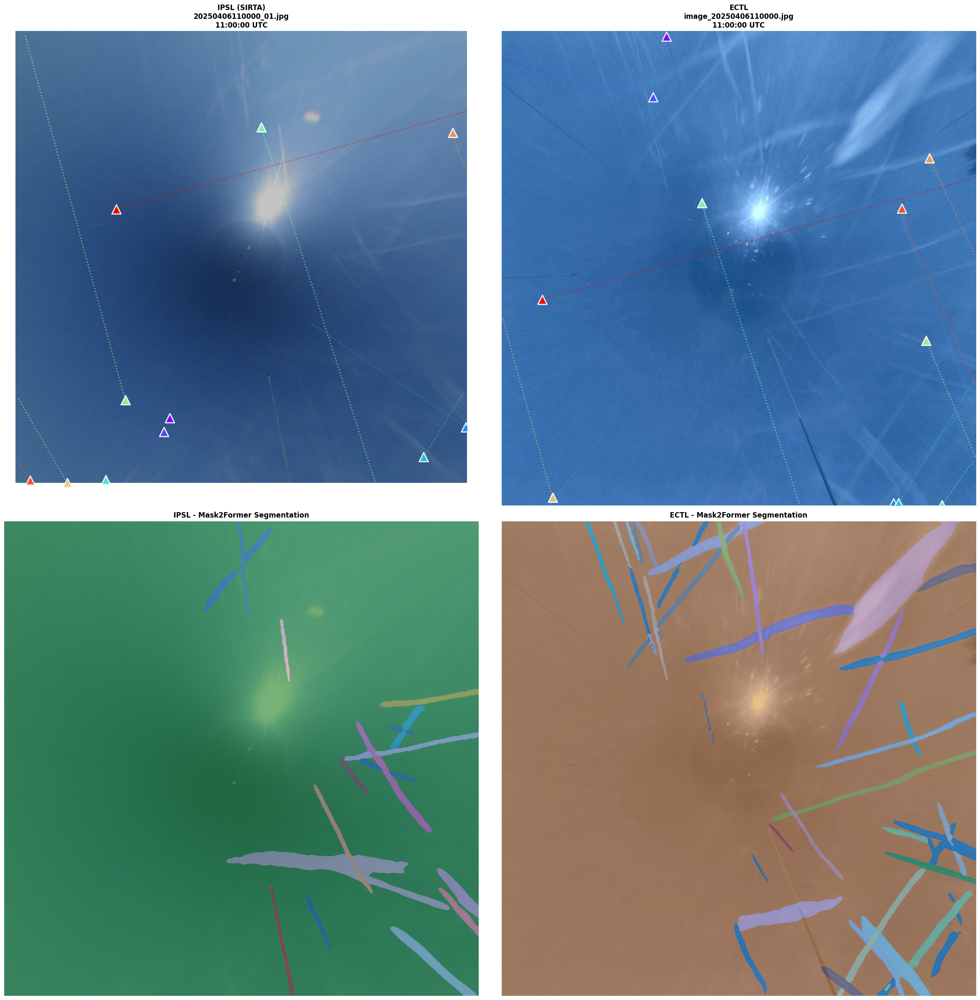


Pair 2: 2025-04-06 11:02:00 UTC
  Visible in IPSL: 16 flights, 356 waypoints
  Visible in ECTL: 16 flights, 422 waypoints
  Running inference...


`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


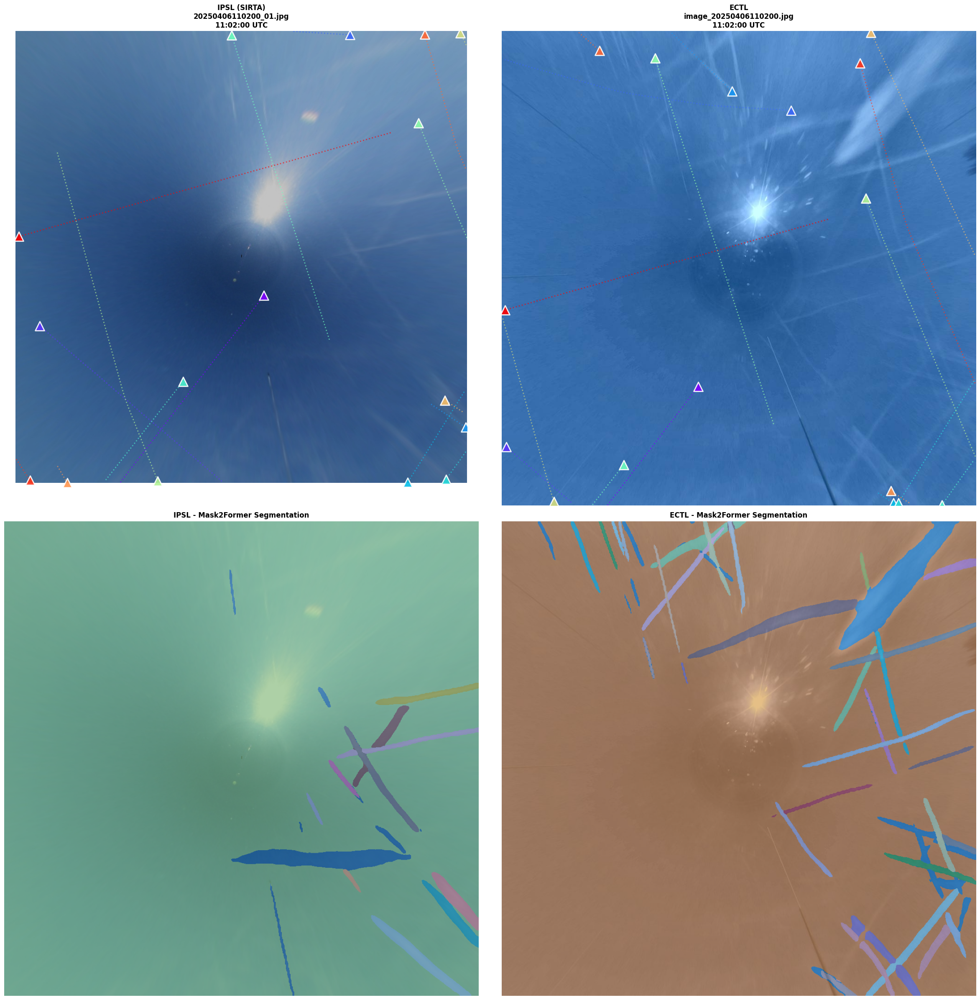


Pair 3: 2025-04-06 11:04:00 UTC
  Visible in IPSL: 18 flights, 438 waypoints
  Visible in ECTL: 17 flights, 497 waypoints
  Running inference...


`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


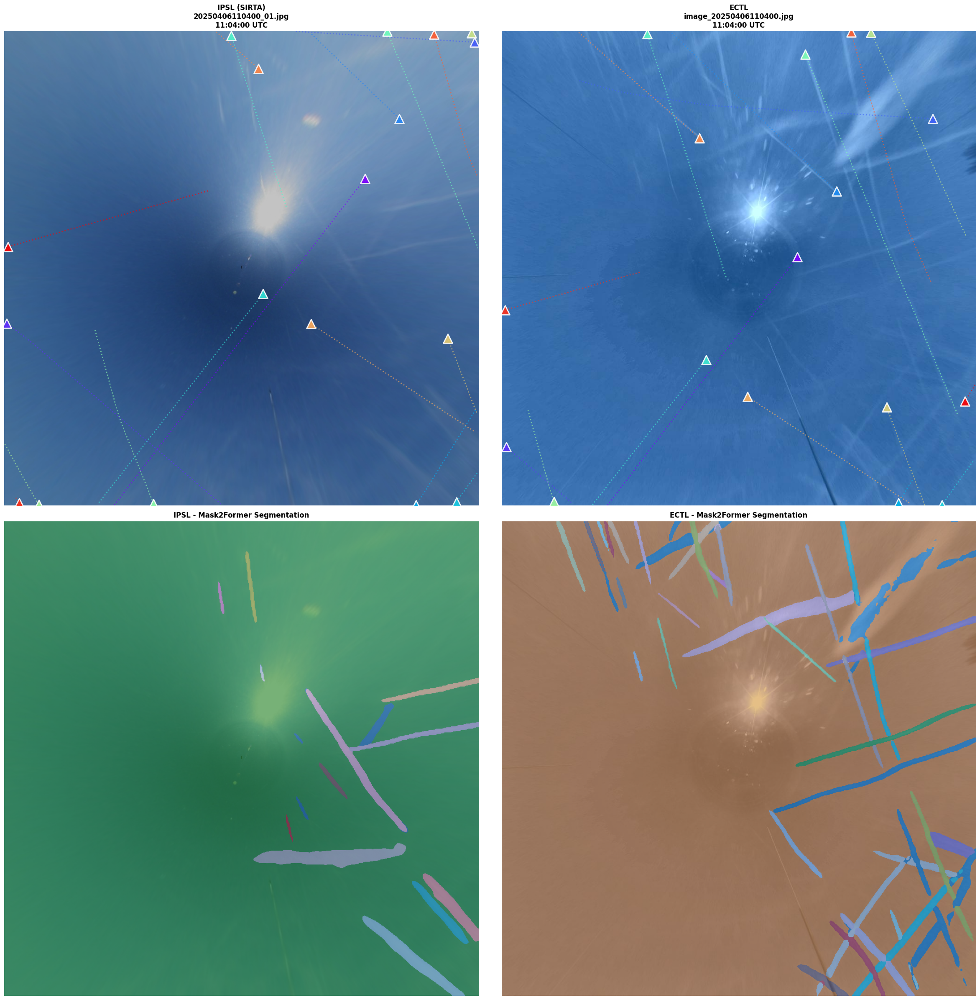


Pair 4: 2025-04-06 11:06:00 UTC
  Visible in IPSL: 18 flights, 424 waypoints
  Visible in ECTL: 17 flights, 525 waypoints
  Running inference...


`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


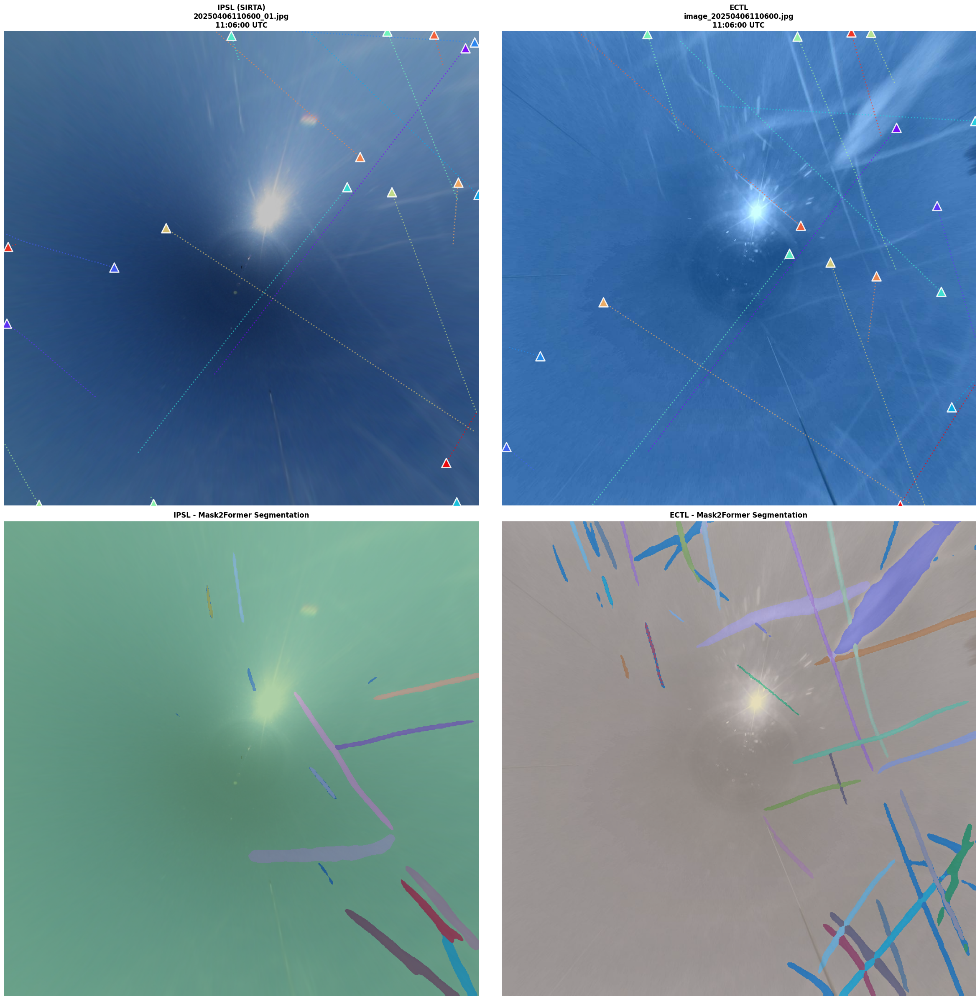


Pair 5: 2025-04-06 11:08:00 UTC
  Visible in IPSL: 16 flights, 448 waypoints
  Visible in ECTL: 16 flights, 555 waypoints
  Running inference...


`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


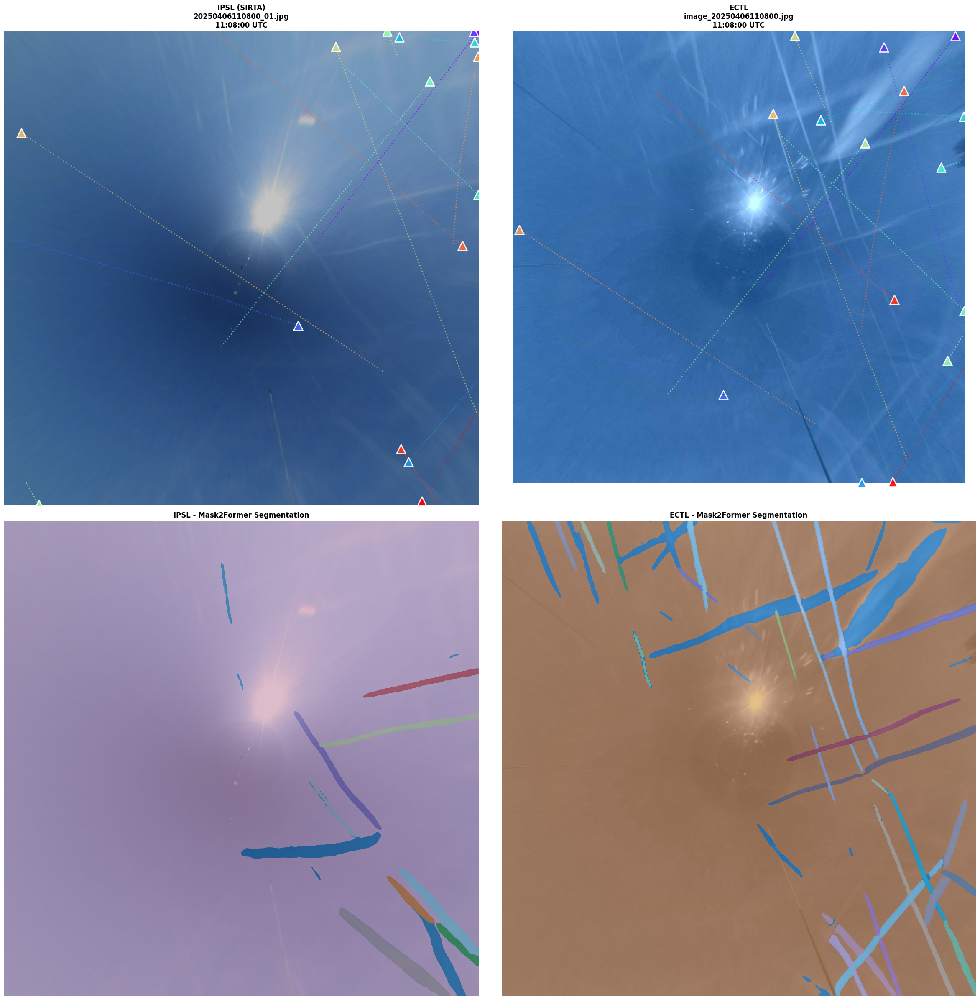


✓ Completed visualization of 5 stereo pairs


In [24]:
# Visualize flights on stereo pairs
for i in range(NUM_PAIRS_TO_VISUALIZE):
    try:
        visualize_flight_on_stereo_pair(
            i, 
            pairs_from_11am[i], 
            flights_all,
            mini_projector_IPSL,
            mini_projector_ECTL,
            time_window_minutes=5
        )
    except Exception as e:
        print(f"\n✗ Error processing pair {i+1}: {e}")
        import traceback
        traceback.print_exc()
        continue

print(f"\n{'='*80}")
print(f"✓ Completed visualization of {NUM_PAIRS_TO_VISUALIZE} stereo pairs")
print(f"{'='*80}")

In [25]:
# Load advection test flights
advection_csv = workspace_dir / "Flights" / "Advection" / "all" / "12-16_advected.csv"

print(f"Loading advection flights from: {advection_csv}")
print(f"  File exists: {advection_csv.exists()}")

if advection_csv.exists():
    # Load the CSV
    advection_flights = pd.read_csv(advection_csv)
    
    # Parse timestamp if it's a string
    if 'timestamp' in advection_flights.columns:
        advection_flights['timestamp'] = pd.to_datetime(advection_flights['timestamp'])
        
        # Make timezone-aware if needed
        if advection_flights['timestamp'].dt.tz is None:
            advection_flights['timestamp'] = advection_flights['timestamp'].dt.tz_localize('UTC')
    
    print(f"\n✓ Loaded {len(advection_flights)} advection flight records")
    print(f"  Columns: {list(advection_flights.columns)}")
    print(f"  Unique flights: {advection_flights['flight_id'].nunique()}")
    
    if 'timestamp' in advection_flights.columns:
        print(f"  Time range: {advection_flights['timestamp'].min()} to {advection_flights['timestamp'].max()}")
    
    # Display sample
    print(f"\nFirst few rows:")
    print(advection_flights.head())
    
    # Project flights using both MiniProjectors
    print(f"\n{'='*80}")
    print("PROJECTING ADVECTION FLIGHTS")
    print(f"{'='*80}")
    
    # Extract coordinates
    lons = advection_flights['longitude'].values
    lats = advection_flights['latitude'].values
    
    # Check if altitude is in geoaltitude column (in feet)
    if 'geoaltitude' in advection_flights.columns:
        alts_ft = advection_flights['geoaltitude'].values
    elif 'altitude' in advection_flights.columns:
        alts_ft = advection_flights['altitude'].values
    else:
        print("⚠ No altitude column found, using default 10000m (32808 ft)")
        alts_ft = np.full(len(advection_flights), 32808.0)
    
    # Project using IPSL MiniProjector
    print("\nProjecting to IPSL camera...")
    px_ipsl, py_ipsl = mini_projector_IPSL.lonlat_to_pixels(lons, lats, alts_ft)
    advection_flights['px_ipsl'] = px_ipsl
    advection_flights['py_ipsl'] = 1024 - py_ipsl  # Flip y-axis
    advection_flights['visible_ipsl'] = (
        ~np.isnan(px_ipsl) & ~np.isnan(py_ipsl) &
        (px_ipsl >= 0) & (px_ipsl < 1024) &
        (py_ipsl >= 0) & (py_ipsl < 1024)
    )
    
    # Project using ECTL MiniProjector
    print("Projecting to ECTL camera...")
    px_ectl, py_ectl = mini_projector_ECTL.lonlat_to_pixels(lons, lats, alts_ft)
    advection_flights['px_ectl'] = px_ectl
    advection_flights['py_ectl'] = 1024 - py_ectl  # Flip y-axis
    advection_flights['visible_ectl'] = (
        ~np.isnan(px_ectl) & ~np.isnan(py_ectl) &
        (px_ectl >= 0) & (px_ectl < 1024) &
        (py_ectl >= 0) & (py_ectl < 1024)
    )
    
    # Count visible flights
    visible_ipsl_count = advection_flights['visible_ipsl'].sum()
    visible_ectl_count = advection_flights['visible_ectl'].sum()
    
    print(f"\n✓ Projection complete:")
    print(f"  Total waypoints: {len(advection_flights)}")
    print(f"  Visible in IPSL: {visible_ipsl_count} ({100*visible_ipsl_count/len(advection_flights):.1f}%)")
    print(f"  Visible in ECTL: {visible_ectl_count} ({100*visible_ectl_count/len(advection_flights):.1f}%)")
    
    # Show sample of visible waypoints
    visible_sample = advection_flights[advection_flights['visible_ipsl'] | advection_flights['visible_ectl']][
        ['flight_id', 'timestamp', 'latitude', 'longitude', 'px_ipsl', 'py_ipsl', 'px_ectl', 'py_ectl', 'visible_ipsl', 'visible_ectl']
    ].head(10)
    
    if len(visible_sample) > 0:
        print(f"\nSample of visible waypoints:")
        print(visible_sample.to_string(index=False))
    
else:
    print(f"✗ Advection CSV file not found: {advection_csv}")

Loading advection flights from: /data/common/STEREOSTUDYIPSL/Flights/Advection/all/12-16_advected.csv
  File exists: True


/tmp/ipykernel_936150/1769853089.py:9: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  advection_flights = pd.read_csv(advection_csv)



✓ Loaded 17602047 advection flight records
  Columns: ['flight_id', 'timestamp', 'icao24', 'registration', 'typecode', 'callsign', 'latitude', 'longitude', 'altitude', 'geoaltitude', 'groundspeed', 'vertical_rate', 'azimuth', 'zenith', 'time', 'waypoint', 'v_wind', 'level', 'sigma_yz', 'width', 'u_wind', 'air_pressure', 'vertical_velocity', 'area_eff', 'air_temperature', 'depth', 'age', 'longitude_advection', 'latitude_advection', 'azimuth_advection', 'time_advection']
  Unique flights: 704
  Time range: 2025-04-06 12:00:00+00:00 to 2025-04-06 15:59:55+00:00

First few rows:
    flight_id                 timestamp  icao24 registration typecode  \
0  MSR778_000 2025-04-06 14:53:00+00:00  01013c       SU-GDN     B77W   
1  MSR778_000 2025-04-06 14:53:05+00:00  01013c       SU-GDN     B77W   
2  MSR778_000 2025-04-06 14:53:10+00:00  01013c       SU-GDN     B77W   
3  MSR778_000 2025-04-06 14:53:15+00:00  01013c       SU-GDN     B77W   
4  MSR778_000 2025-04-06 14:53:20+00:00  01013c     

In [ ]:
# Load advection test flights
advection_csv = workspace_dir / "Flights" / "Advection" / "all" / "12-16_advected.csv"

print(f"Loading advection flights from: {advection_csv}")
print(f"  File exists: {advection_csv.exists()}")

if advection_csv.exists():
    # Load the CSV
    advection_flights = pd.read_csv(advection_csv)
    
    # Drop the first 'timestamp' column if duplicated
    timestamp_cols = [col for col in advection_flights.columns if col == 'timestamp']
    if len(timestamp_cols) > 1:
        # Drop the first occurrence
        first_idx = advection_flights.columns.get_loc('timestamp')
        advection_flights = advection_flights.drop(advection_flights.columns[first_idx], axis=1)
        print("✓ Dropped first duplicate 'timestamp' column")
    
    # Parse timestamp if it's a string
    if 'timestamp' in advection_flights.columns:
        advection_flights['timestamp'] = pd.to_datetime(advection_flights['timestamp'])
        # Make timezone-aware if needed
        if advection_flights['timestamp'].dt.tz is None:
            advection_flights['timestamp'] = advection_flights['timestamp'].dt.tz_localize('UTC')
    
    print(f"\n✓ Loaded {len(advection_flights)} advection flight records")
    print(f"  Columns: {list(advection_flights.columns)}")
    print(f"  Unique flights: {advection_flights['flight_id'].nunique()}")
    if 'timestamp' in advection_flights.columns:
        print(f"  Time range: {advection_flights['timestamp'].min()} to {advection_flights['timestamp'].max()}")
    print(f"\nFirst few rows:")
    print(advection_flights.head())
    
    # Project flights using both MiniProjectors
    print(f"\n{'='*80}")
    print("PROJECTING ADVECTION FLIGHTS")
    print(f"{'='*80}")
    
    # Extract coordinates
    lons = advection_flights['longitude'].values
    lats = advection_flights['latitude'].values
    
    # Check if altitude is in geoaltitude column (in feet)
    if 'geoaltitude' in advection_flights.columns:
        alts_ft = advection_flights['geoaltitude'].values
    elif 'altitude' in advection_flights.columns:
        alts_ft = advection_flights['altitude'].values
    else:
        print("⚠ No altitude column found, using default 10000m (32808 ft)")
        alts_ft = np.full(len(advection_flights), 32808.0)
    
    # Project using IPSL MiniProjector
    print("\nProjecting to IPSL camera...")
    px_ipsl, py_ipsl = mini_projector_IPSL.lonlat_to_pixels(lons, lats, alts_ft)
    advection_flights['px_ipsl'] = px_ipsl
    advection_flights['py_ipsl'] = 1024 - py_ipsl  # Flip y-axis
    advection_flights['visible_ipsl'] = (
        ~np.isnan(px_ipsl) & ~np.isnan(py_ipsl) &
        (px_ipsl >= 0) & (px_ipsl < 1024) &
        (py_ipsl >= 0) & (py_ipsl < 1024)
    )
    
    # Project using ECTL MiniProjector
    print("Projecting to ECTL camera...")
    px_ectl, py_ectl = mini_projector_ECTL.lonlat_to_pixels(lons, lats, alts_ft)
    advection_flights['px_ectl'] = px_ectl
    advection_flights['py_ectl'] = 1024 - py_ectl  # Flip y-axis
    advection_flights['visible_ectl'] = (
        ~np.isnan(px_ectl) & ~np.isnan(py_ectl) &
        (px_ectl >= 0) & (px_ectl < 1024) &
        (py_ectl >= 0) & (py_ectl < 1024)
    )
    
    # Count visible flights
    visible_ipsl_count = advection_flights['visible_ipsl'].sum()
    visible_ectl_count = advection_flights['visible_ectl'].sum()
    
    print(f"\n✓ Projection complete:")
    print(f"  Total waypoints: {len(advection_flights)}")
    print(f"  Visible in IPSL: {visible_ipsl_count} ({100*visible_ipsl_count/len(advection_flights):.1f}%)")
    print(f"  Visible in ECTL: {visible_ectl_count} ({100*visible_ectl_count/len(advection_flights):.1f}%)")
    
    # Show sample of visible waypoints
    visible_sample = advection_flights[advection_flights['visible_ipsl'] | advection_flights['visible_ectl']][
        ['flight_id', 'timestamp', 'latitude', 'longitude', 'px_ipsl', 'py_ipsl', 'px_ectl', 'py_ectl', 'visible_ipsl', 'visible_ectl']
    ].head(10)
    
    if len(visible_sample) > 0:
        print(f"\nSample of visible waypoints:")
        print(visible_sample.to_string(index=False))
else:
    print(f"✗ Advection CSV file not found: {advection_csv}")

Loading advection flights from: /data/common/STEREOSTUDYIPSL/Flights/Advection/all/test.csv
  File exists: True


/tmp/ipykernel_420507/3528303359.py:9: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  advection_flights = pd.read_csv(advection_csv)



✓ Loaded 8494926 advection flight records
  Columns: ['flight_id', 'timestamp', 'icao24', 'registration', 'typecode', 'callsign', 'latitude', 'longitude', 'altitude', 'geoaltitude', 'groundspeed', 'vertical_rate', 'azimuth', 'zenith', 'distance_from_center_km', 'timestamp.1', 'waypoint', 'age', 'depth', 'air_temperature', 'width', 'v_wind', 'sigma_yz', 'vertical_velocity', 'air_pressure', 'area_eff', 'u_wind', 'level', 'time_advection', 'longitude_advection', 'latitude_advection', 'azimuth_advection']
  Unique flights: 1022
  Time range: 2025-04-06 04:03:55+00:00 to 2025-04-06 17:59:55+00:00

First few rows:
     flight_id                 timestamp  icao24 registration typecode  \
0  RAM845X_005 2025-04-06 05:46:25+00:00  020113       CN-RGR     E190   
1  RAM845X_005 2025-04-06 05:46:30+00:00  020113       CN-RGR     E190   
2  RAM845X_005 2025-04-06 05:46:35+00:00  020113       CN-RGR     E190   
3  RAM845X_005 2025-04-06 05:46:40+00:00  020113       CN-RGR     E190   
4  RAM845X_00

/tmp/ipykernel_420507/3499137417.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/data/dataiku/.conda/envs/stereo/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


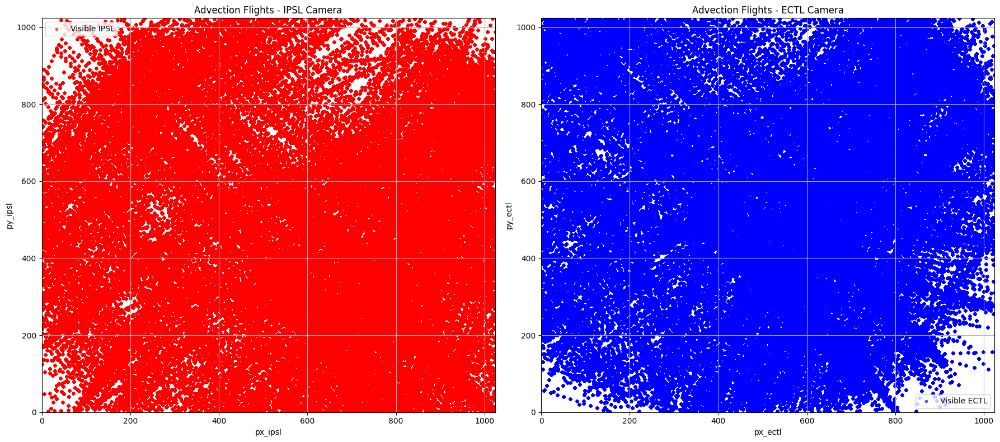

In [ ]:
import matplotlib.pyplot as plt

# Visualize projected advection flights for both cameras
def plot_advection_projection(advection_flights):
    fig, axes = plt.subplots(1, 2, figsize=(18, 8))
    
    # IPSL
    ax1 = axes[0]
    visible_ipsl = advection_flights[advection_flights['visible_ipsl']]
    ax1.scatter(visible_ipsl['px_ipsl'], visible_ipsl['py_ipsl'], s=10, c='red', alpha=0.6, label='Visible IPSL')
    ax1.set_xlim(0, 1024)
    ax1.set_ylim(0, 1024)
    ax1.set_title('Advection Flights - IPSL Camera')
    ax1.set_xlabel('px_ipsl')
    ax1.set_ylabel('py_ipsl')
    ax1.legend()
    ax1.grid(True)

    # ECTL
    ax2 = axes[1]
    visible_ectl = advection_flights[advection_flights['visible_ectl']]
    ax2.scatter(visible_ectl['px_ectl'], visible_ectl['py_ectl'], s=10, c='blue', alpha=0.6, label='Visible ECTL')
    ax2.set_xlim(0, 1024)
    ax2.set_ylim(0, 1024)
    ax2.set_title('Advection Flights - ECTL Camera')
    ax2.set_xlabel('px_ectl')
    ax2.set_ylabel('py_ectl')
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

# Call the function if advection_flights is loaded
if 'advection_flights' in locals():
    plot_advection_projection(advection_flights)
else:
    print("No advection_flights data loaded.")

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


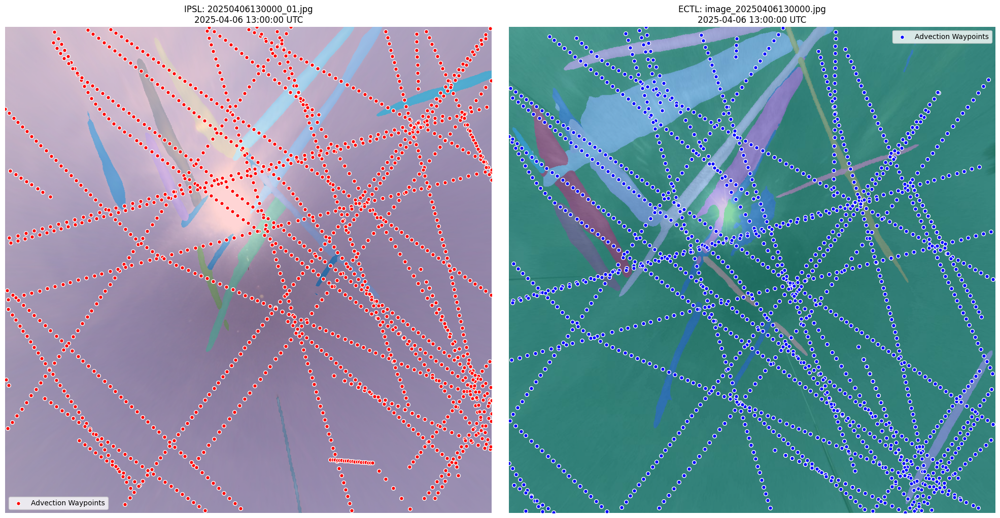

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


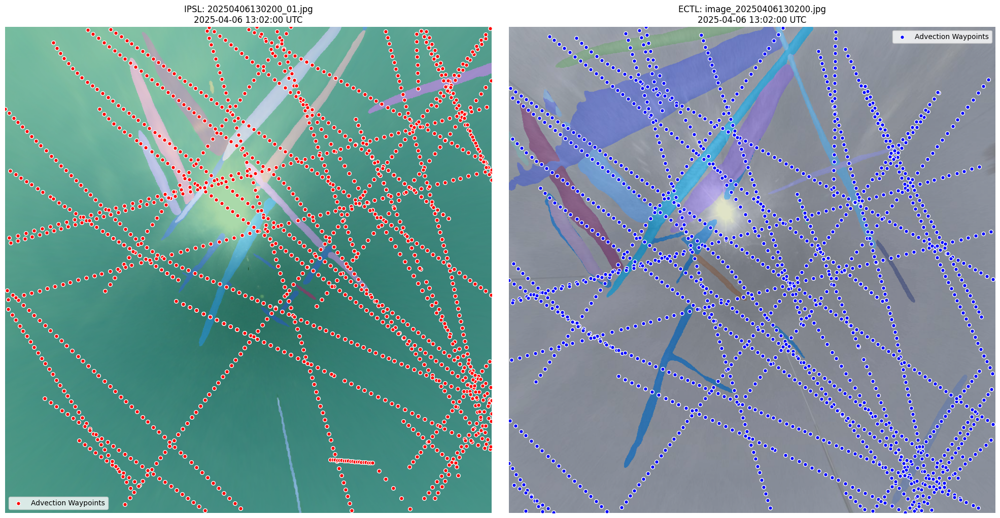

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


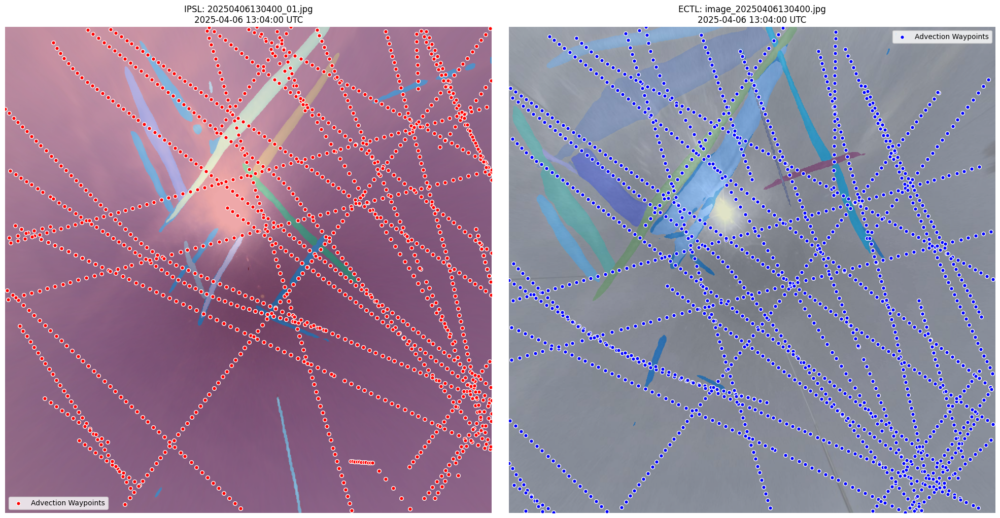

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


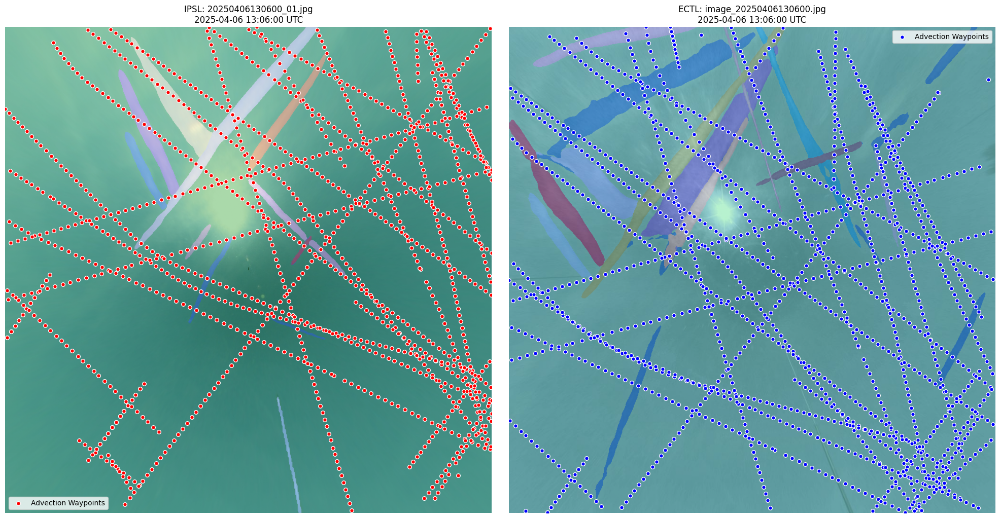

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


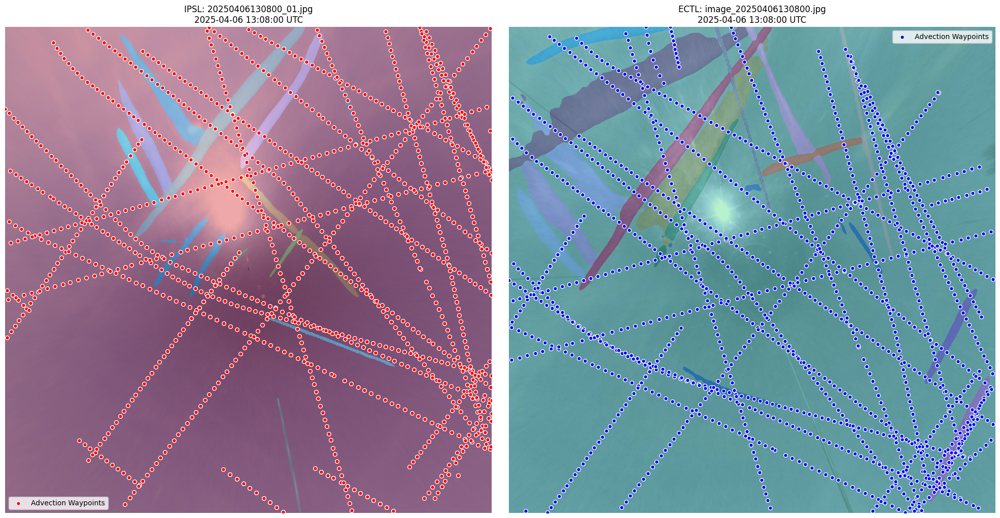

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


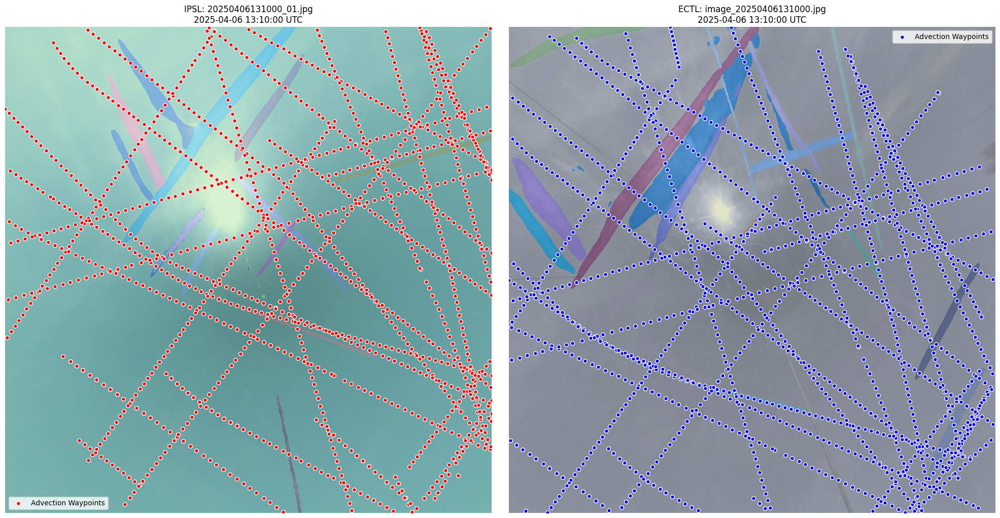

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


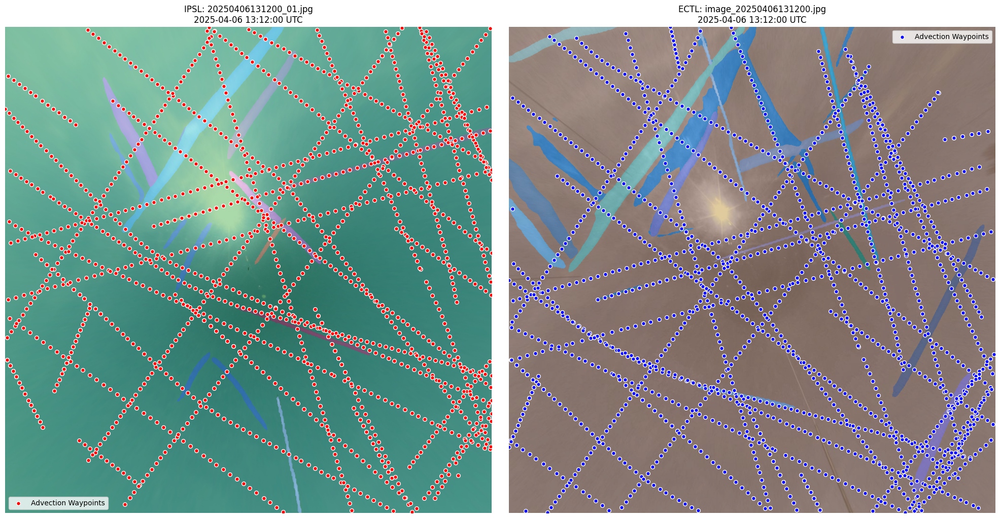

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


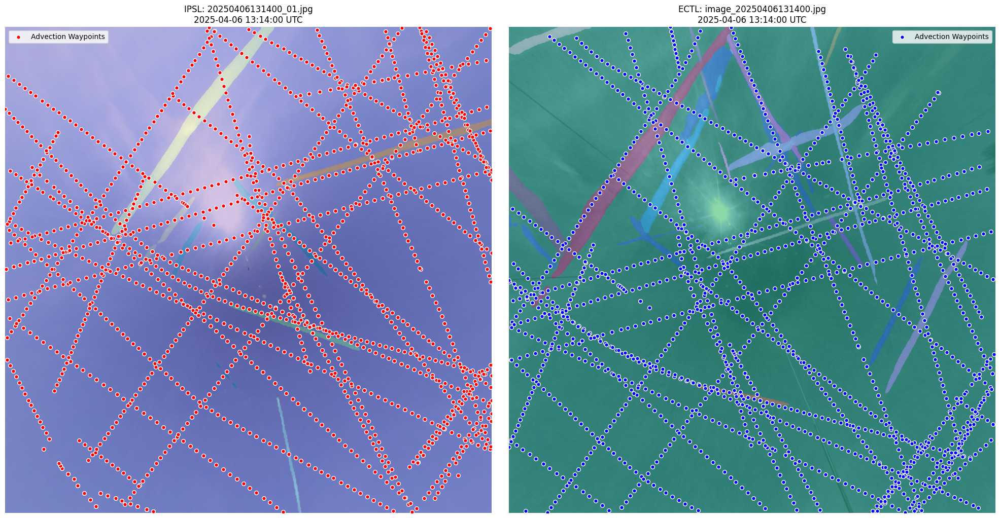

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


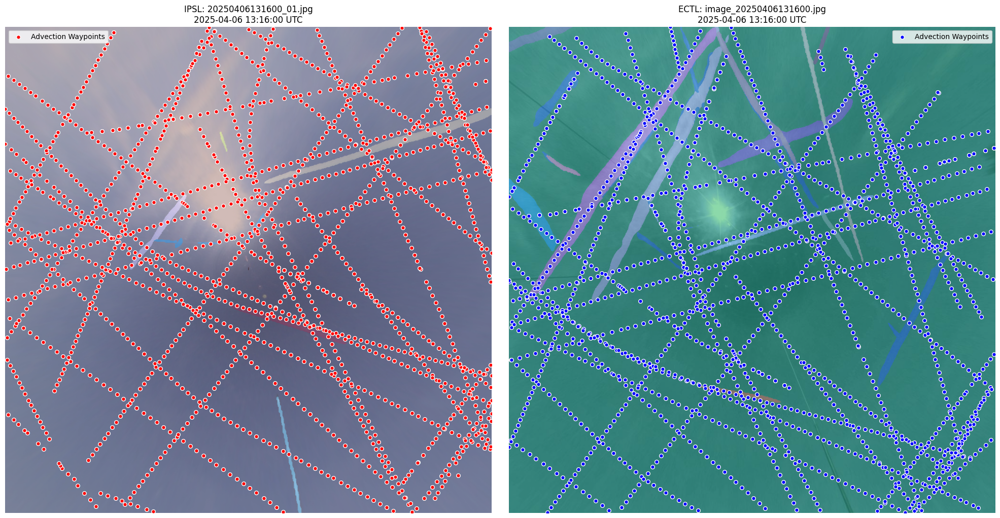

`label_ids_to_fuse` unset. No instance will be fused.
`label_ids_to_fuse` unset. No instance will be fused.


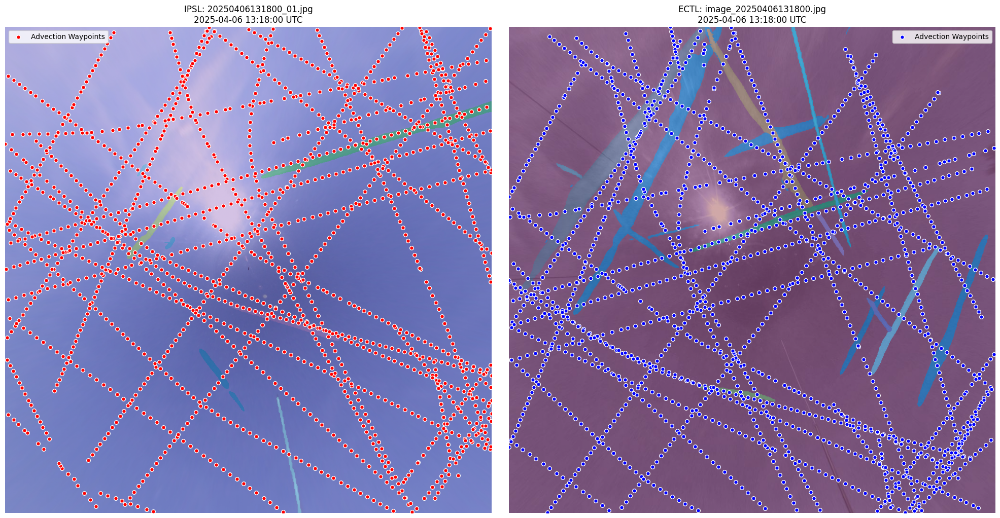

In [ ]:
import matplotlib.pyplot as plt

def plot_advection_on_images(pair, advection_flights, mini_projector_IPSL, mini_projector_ECTL, time_window_minutes=0):
    # Filter advection flights for the image timestamp window
    timestamp = pair['timestamp']
    if timestamp.tzinfo is None:
        timestamp = pytz.UTC.localize(timestamp)
    time_window = pd.Timedelta(minutes=time_window_minutes)
    flights_window = advection_flights[
        (advection_flights['time_advection'].dt.tz_localize('UTC') <= timestamp) &
        (advection_flights['time_advection'].dt.tz_localize('UTC') >= timestamp - time_window)
    ]
    flights_window = flights_window[
    (flights_window['time_advection'].dt.tz_localize('UTC') - flights_window['timestamp']) < pd.Timedelta(minutes=30)
    ]
    if len(flights_window) == 0:
        print("No advection flights in this time window.")
        return

    # Load images
    ipsl_image = np.array(Image.open(pair['ipsl_path']).convert('RGB'))
    ectl_image = np.array(Image.open(pair['ectl_path']).convert('RGB'))
    ectl_image = np.flipud(ectl_image)

    # Run segmentation
    ipsl_seg = run_inference(ipsl_image)
    ectl_seg = run_inference(ectl_image)

    # Prepare figure
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    # IPSL
    ax1 = axes[0]
    ax1.imshow(ipsl_image)
    if 'segmentation' in ipsl_seg:
        ipsl_mask = ipsl_seg['segmentation'].cpu().numpy()
        ax1.imshow(ipsl_mask, alpha=0.4, cmap='tab20')
    visible_ipsl = flights_window[flights_window['visible_ipsl']]
    ax1.scatter(visible_ipsl['px_ipsl'], visible_ipsl['py_ipsl'], s=30, c='red', edgecolors='white', label='Advection Waypoints')
    ax1.set_title(f'IPSL: {pair["ipsl_filename"]}\n{timestamp.strftime("%Y-%m-%d %H:%M:%S UTC")}')
    ax1.set_xlim(0, 1024)
    ax1.set_ylim(1024, 0)
    ax1.legend()
    ax1.axis('off')

    # ECTL
    ax2 = axes[1]
    ax2.imshow(ectl_image)
    if 'segmentation' in ectl_seg:
        ectl_mask = ectl_seg['segmentation'].cpu().numpy()
        ax2.imshow(ectl_mask, alpha=0.4, cmap='tab20')
    visible_ectl = flights_window[flights_window['visible_ectl']]
    ax2.scatter(visible_ectl['px_ectl'], visible_ectl['py_ectl'], s=30, c='blue', edgecolors='white', label='Advection Waypoints')
    ax2.set_title(f'ECTL: {pair["ectl_filename"]}\n{timestamp.strftime("%Y-%m-%d %H:%M:%S UTC")}')
    ax2.set_xlim(0, 1024)
    ax2.set_ylim(1024, 0)
    ax2.legend()
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

# Example usage: plot for the first 10 matched stereo pairs
if 'advection_flights' in locals() and len(matched_pairs) > 0:
    for i in range(min(10, len(matched_pairs))):
        plot_advection_on_images(
            matched_pairs[i],
            advection_flights,
            mini_projector_IPSL,
            mini_projector_ECTL,
            time_window_minutes=1
        )
else:
    print("No advection_flights data or matched_pairs available.")

In [ ]:
print(advection_flights.columns)

Index(['flight_id', 'timestamp', 'icao24', 'registration', 'typecode',
       'callsign', 'latitude', 'longitude', 'altitude', 'geoaltitude',
       'groundspeed', 'vertical_rate', 'azimuth', 'zenith',
       'distance_from_center_km', 'timestamp.1', 'waypoint', 'age', 'depth',
       'air_temperature', 'width', 'v_wind', 'sigma_yz', 'vertical_velocity',
       'air_pressure', 'area_eff', 'u_wind', 'level', 'time_advection',
       'longitude_advection', 'latitude_advection', 'azimuth_advection',
       'px_ipsl', 'py_ipsl', 'visible_ipsl', 'px_ectl', 'py_ectl',
       'visible_ectl'],
      dtype='object')


In [23]:
flight_id_counts = advection_flights['flight_id'].value_counts()
print("\nFlight ID counts:")
print(flight_id_counts)


Flight ID counts:
flight_id
MSURF_1394      18271
EMC6_1230       17545
SLS7B_2625      15972
N291AH_2799     14157
OYO9_146        13915
                ...  
AFR17ZG_124       363
AFR28PR_364       363
MAC828P_021       242
3Y78 K5H_973      242
AFR34QV_371       242
Name: count, Length: 1022, dtype: int64


In [26]:
flight_test_id = 'MSURF_1394'
flight_test = advection_flights[advection_flights['flight_id'] == flight_test_id]
print("\nSample data for flight MSURF_1394:")
print(flight_test.head(10))


Sample data for flight MSURF_1394:
          flight_id                 timestamp  icao24 registration typecode  \
6367020  MSURF_1394 2025-04-06 14:16:15+00:00  43e7ed       M-SURF     PC12   
6367021  MSURF_1394 2025-04-06 14:16:20+00:00  43e7ed       M-SURF     PC12   
6367022  MSURF_1394 2025-04-06 14:16:25+00:00  43e7ed       M-SURF     PC12   
6367023  MSURF_1394 2025-04-06 14:16:30+00:00  43e7ed       M-SURF     PC12   
6367024  MSURF_1394 2025-04-06 14:16:35+00:00  43e7ed       M-SURF     PC12   
6367025  MSURF_1394 2025-04-06 14:16:40+00:00  43e7ed       M-SURF     PC12   
6367026  MSURF_1394 2025-04-06 14:16:45+00:00  43e7ed       M-SURF     PC12   
6367027  MSURF_1394 2025-04-06 14:16:50+00:00  43e7ed       M-SURF     PC12   
6367028  MSURF_1394 2025-04-06 14:16:55+00:00  43e7ed       M-SURF     PC12   
6367029  MSURF_1394 2025-04-06 14:17:00+00:00  43e7ed       M-SURF     PC12   

        callsign   latitude  longitude  altitude  geoaltitude  ...  \
6367020    MSURF  48.938

In [27]:
flight_test_id = 'MSURF_1394'
flight_test = advection_flights[advection_flights['flight_id'] == flight_test_id]
print("\nSample data for flight MSURF_1394 (timestamp and time_advection):")
print(flight_test[['timestamp', 'time_advection']].head(200))


Sample data for flight MSURF_1394 (timestamp and time_advection):
                        timestamp       time_advection
6367020 2025-04-06 14:16:15+00:00  2025-04-06 14:16:15
6367021 2025-04-06 14:16:20+00:00  2025-04-06 14:16:20
6367022 2025-04-06 14:16:25+00:00  2025-04-06 14:16:25
6367023 2025-04-06 14:16:30+00:00  2025-04-06 14:16:30
6367024 2025-04-06 14:16:35+00:00  2025-04-06 14:16:35
...                           ...                  ...
6367215 2025-04-06 14:21:15+00:00  2025-04-06 14:22:00
6367216 2025-04-06 14:21:20+00:00  2025-04-06 14:22:00
6367217 2025-04-06 14:21:25+00:00  2025-04-06 14:22:00
6367218 2025-04-06 14:21:30+00:00  2025-04-06 14:22:00
6367219 2025-04-06 14:21:35+00:00  2025-04-06 14:22:00

[200 rows x 2 columns]


In [30]:
# Print data type of time_advection column
print("\nData type of 'time_advection' column:")
print(advection_flights['time_advection'].dtype)


Data type of 'time_advection' column:
object


In [31]:
# turn it into datetime if not already
if advection_flights['time_advection'].dtype == 'object':
    advection_flights['time_advection'] = pd.to_datetime(advection_flights['time_advection'])
    print("Converted 'time_advection' to datetime.")

Converted 'time_advection' to datetime.


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

def plot_advection_on_images(pair, advection_flights, mini_projector_IPSL, mini_projector_ECTL, time_window_minutes=0):
    # Filter advection flights for the image timestamp window
    timestamp = pair['timestamp']
    if timestamp.tzinfo is None:
        timestamp = pytz.UTC.localize(timestamp)
    time_window = pd.Timedelta(minutes=time_window_minutes)
    flights_window = advection_flights[
        (advection_flights['time_advection'] <= timestamp) &
        (advection_flights['time_advection'] >= timestamp - time_window)
    ]
    flights_window = flights_window[
        (flights_window['time_advection'] - flights_window['timestamp']) < pd.Timedelta(minutes=30)
    ]
    if len(flights_window) == 0:
        print("No advection flights in this time window.")
        return

    # Load images
    ipsl_image = np.array(Image.open(pair['ipsl_path']).convert('RGB'))
    ectl_image = np.array(Image.open(pair['ectl_path']).convert('RGB'))
    ectl_image = np.flipud(ectl_image)

    # Run segmentation
    ipsl_seg = run_inference(ipsl_image)
    ectl_seg = run_inference(ectl_image)

    # Prepare figure
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    # Assign a unique color to each flight
    unique_flights = flights_window['flight_id'].unique()
    color_map = plt.cm.get_cmap('tab20', len(unique_flights))

    # IPSL
    ax1 = axes[0]
    ax1.imshow(ipsl_image)
    if 'segmentation' in ipsl_seg:
        ipsl_mask = ipsl_seg['segmentation'].cpu().numpy()
        ax1.imshow(ipsl_mask, alpha=0.4, cmap='tab20')
    for i, flight_id in enumerate(unique_flights):
        flight_points = flights_window[(flights_window['flight_id'] == flight_id) & flights_window['visible_ipsl']]
        if len(flight_points) == 0:
            continue
        # Normalize time for alpha (older = lighter)
        times = (flight_points['time_advection'] - flight_points['time_advection'].min()).dt.total_seconds()
        if times.max() > 0:
            alphas = 0.3 + 0.7 * (times / times.max())  # 0.3 (oldest) to 1.0 (newest)
        else:
            alphas = np.ones(len(flight_points))
        color = color_map(i)
        for (x, y, a) in zip(flight_points['px_ipsl'], flight_points['py_ipsl'], alphas):
            ax1.scatter(x, y, s=30, color=color, edgecolors='white', alpha=a, label=None)
        # Draw a line for the flight
        ax1.plot(flight_points['px_ipsl'], flight_points['py_ipsl'], '-', color=color, alpha=0.7, linewidth=2, label=str(flight_id))
    ax1.set_title(f'IPSL: {pair["ipsl_filename"]}\n{timestamp.strftime("%Y-%m-%d %H:%M:%S UTC")}')
    ax1.set_xlim(0, 1024)
    ax1.set_ylim(1024, 0)
    ax1.axis('off')
    ax1.legend(title="Flight ID", loc='upper right', fontsize='small')

    # ECTL
    ax2 = axes[1]
    ax2.imshow(ectl_image)
    if 'segmentation' in ectl_seg:
        ectl_mask = ectl_seg['segmentation'].cpu().numpy()
        ax2.imshow(ectl_mask, alpha=0.4, cmap='tab20')
    for i, flight_id in enumerate(unique_flights):
        flight_points = flights_window[(flights_window['flight_id'] == flight_id) & flights_window['visible_ectl']]
        if len(flight_points) == 0:
            continue
        times = (flight_points['time_advection'] - flight_points['time_advection'].min()).dt.total_seconds()
        if times.max() > 0:
            alphas = 0.3 + 0.7 * (times / times.max())
        else:
            alphas = np.ones(len(flight_points))
        color = color_map(i)
        for (x, y, a) in zip(flight_points['px_ectl'], flight_points['py_ectl'], alphas):
            ax2.scatter(x, y, s=30, color=color, edgecolors='white', alpha=a, label=None)
        ax2.plot(flight_points['px_ectl'], flight_points['py_ectl'], '-', color=color, alpha=0.7, linewidth=2, label=str(flight_id))
    ax2.set_title(f'ECTL: {pair["ectl_filename"]}\n{timestamp.strftime("%Y-%m-%d %H:%M:%S UTC")}')
    ax2.set_xlim(0, 1024)
    ax2.set_ylim(1024, 0)
    ax2.axis('off')
    ax2.legend(title="Flight ID", loc='upper right', fontsize='small')

    plt.tight_layout()
    plt.show()